<a href="https://colab.research.google.com/github/natasha-alcaide/bubble-tracking-IC-UFPR/blob/main/bubble_tracking_ic_ufpr.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Mineração de dados petrolíferos usando visão computacional

Este notebook reúne os códigos desenvolvidos no âmbito do projeto de **Iniciação Científica** realizado na Universidade Federal do Paraná (UFPR), intitulado:

**"Mineração de dados petrolíferos usando técnicas de visão computacional em imagens de escoamento de petróleo".**

---

## Estrutura do notebook

Cada seção apresenta:

- **Objetivo do código**: breve descrição do que está sendo implementado.  
- **Metodologia**: abordagem utilizada, técnicas de processamento e rastreamento.  
- **Parâmetros principais**: valores relevantes testados ou ajustados.  
- **Resultados**: exemplos de saídas visuais ou métricas obtidas.  

---

📜 **Autoria:** Natasha Alcaide (UFPR, 2025)  
Este material complementa o relatório final submetido à Iniciação Científica (IC-UFPR).


## 1. Testes com imagens estáticas — Canny + contornos (sem filtro)

**Objetivo:** aplicar o detector de bordas Canny em imagens estáticas para identificar bolhas, extraindo contornos e calculando métricas de área e perímetro.

**Procedimento:**
- Conversão da imagem para escala de cinza.  
- Aplicação do detector de bordas Canny (limiares 100 e 400).  
- Extração dos contornos externos com `cv2.findContours`.  
- Cálculo de área e perímetro de cada contorno.  
- Desenho dos contornos em máscara binária para fins de visualização.  

**Saídas obtidas:**
- Registro em log com área e perímetro de cada contorno.  
- Imagem processada com contornos destacados.  

**Observações:**  
O método reconheceu a bolha principal, mas apresentou elevado nível de ruído, resultando em múltiplas detecções falsas.  

**Tempo de processamento:** ~13 s por imagem de 121 KB.


Saving P04_C001H001S0001001479.bmp to P04_C001H001S0001001479 (1).bmp
Área: 0.0, Perímetro: 8.8
Área: 0.0, Perímetro: 8.0
Área: 131.0, Perímetro: 489.2
Área: 96.0, Perímetro: 734.0
Área: 11.5, Perímetro: 37.6
Área: 5.5, Perímetro: 415.3
Área: 5.0, Perímetro: 11.7
Área: 16.5, Perímetro: 300.2
Área: 1.0, Perímetro: 11.7
Área: 0.0, Perímetro: 6.0
Área: 7.0, Perímetro: 36.1
Área: 4.0, Perímetro: 11.7
Área: 6.0, Perímetro: 29.3
Área: 1.0, Perímetro: 22.5
Área: 6.5, Perímetro: 79.0
Área: 0.5, Perímetro: 10.2
Área: 19.5, Perímetro: 19.1
Área: 17.5, Perímetro: 33.6
Área: 8.5, Perímetro: 13.9
Área: 0.0, Perímetro: 13.7
Área: 7.5, Perímetro: 12.2
Área: 1.5, Perímetro: 16.2
Área: 1.0, Perímetro: 13.7
Área: 11.5, Perímetro: 48.9
Área: 201.5, Perímetro: 1470.4
Área: 21.5, Perímetro: 59.4
Área: 13.0, Perímetro: 123.9
Área: 2.5, Perímetro: 58.5
Área: 10.0, Perímetro: 167.1
Área: 113.0, Perímetro: 517.8
Área: 189.5, Perímetro: 2571.1
Área: 28.5, Perímetro: 101.6
Área: 113.0, Perímetro: 207.5
Área: 46.

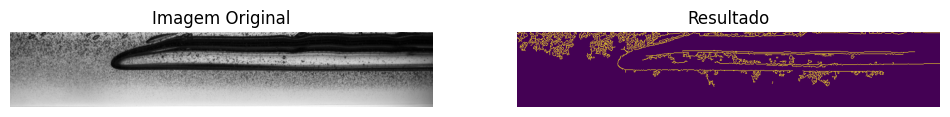

In [ ]:

import numpy as np
import matplotlib.pyplot as plt
import cv2
from google.colab import files

##############################################

uploaded = files.upload()


for filename in uploaded.keys():
    image_path = filename


img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)


edges = cv2.Canny(img, 100, 400)


contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)


contour_img = np.zeros_like(img)


for cnt in contours:
    area = cv2.contourArea(cnt)
    perimeter = cv2.arcLength(cnt, True)


    print(f"Área: {area:.1f}, Perímetro: {perimeter:.1f}")


    cv2.drawContours(contour_img, [cnt], -1, (255), thickness=1)



plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.title('Imagem Original')
plt.imshow(img, cmap='gray')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title('Resultado')
plt.imshow(contour_img)
plt.axis('off')

plt.show()




## 2. Imagens estáticas — Canny com filtro por área mínima (1000 px)

**Objetivo:** reduzir o ruído na detecção de bolhas por meio da exclusão de contornos pequenos.

**Procedimento:**
- Reutilização do pipeline anterior (Canny + contornos).  
- Inclusão de filtro para descartar contornos com área inferior a 1000 px.  
- Parâmetro-chave: `area_min = 1000`.  

**Saídas obtidas:**
- Log atualizado com contornos válidos (≥ 1000 px).  
- Imagem com menor número de contornos em comparação ao teste anterior.  

**Observações:**  
Embora tenha reduzido o ruído, o critério foi excessivamente rígido e resultou na perda da bolha principal (*under-segmentation*).  

**Tempo de processamento:** ~9 s por imagem de 121 KB.


Saving P04_C001H001S0001001479.bmp to P04_C001H001S0001001479 (2).bmp
Área: 1287.5, Perímetro: 983.3
Área: 1175.5, Perímetro: 3854.4
Área: 1602.0, Perímetro: 1978.7


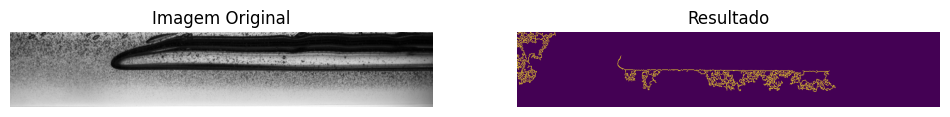

In [ ]:

import numpy as np
import matplotlib.pyplot as plt
import cv2
from google.colab import files


uploaded = files.upload()


for filename in uploaded.keys():
    image_path = filename


img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)


edges = cv2.Canny(img, 50, 150)


contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)


contour_img = np.zeros_like(img)

# limite de área para não pegar ruídos
area_min = 1000

#calcular a área e desenhar os contornos só das bolhas que o programa reconheceu
for cnt in contours:
    area = cv2.contourArea(cnt)
    perimeter = cv2.arcLength(cnt, True)


    if area >= area_min:


        print(f"Área: {area:.1f}, Perímetro: {perimeter:.1f}")


        cv2.drawContours(contour_img, [cnt], -1, (255), thickness=1)


plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.title('Imagem Original')
plt.imshow(img, cmap='gray')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title('Resultado')
plt.imshow(contour_img)
plt.axis('off')
plt.show()


## 3. Imagens estáticas — Gaussian Blur + Adaptive Threshold

**Objetivo:** aprimorar a segmentação da bolha por meio de suavização da imagem e aplicação de limiar adaptativo.

**Procedimento:**
- Aplicação do filtro `GaussianBlur` para reduzir ruídos de alta frequência.  
- Binarização local da imagem com `adaptiveThreshold(..., THRESH_BINARY_INV, blockSize=11, C=2)`.  
- Extração de contornos, mantendo apenas aqueles com área superior a 500 px.  

**Saídas obtidas:**
- Log contendo área e perímetro dos contornos preservados.  
- Imagem processada com contornos mais definidos em relação aos testes anteriores.  

**Observações:**  
O contorno da bolha principal apresentou maior precisão; entretanto, ainda foram observados ruídos residuais.  

**Tempo de processamento:** ~10 s por imagem de 121 KB.


Saving P04_C001H001S0001001479.bmp to P04_C001H001S0001001479 (3).bmp
Área: 12783.5, Perímetro: 5180.0


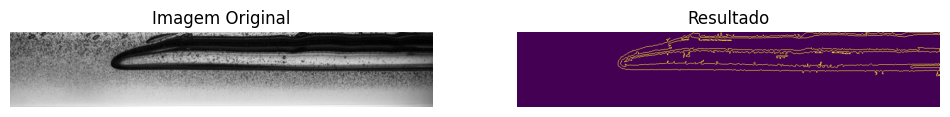

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from google.colab import files

# Upload da imagem
uploaded = files.upload()

# Ler o arquivo carregado
for filename in uploaded.keys():
    image_path = filename

# Carregar a imagem em escala de cinza
img = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Aplicar filtro Gaussiano para suavizar e reduzir ruído
blurred = cv2.GaussianBlur(img, (5, 5), 0)

# Aplicar limiar adaptativo para destacar melhor os contornos
thresh = cv2.adaptiveThreshold(blurred, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C,
                               cv2.THRESH_BINARY_INV, 11, 2)

# Encontrar contornos
contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Criar uma máscara preta para desenhar os contornos
contour_img = np.zeros_like(img)

# Filtrar contornos para remover ruídos pequenos
filtered_contours = [cnt for cnt in contours if cv2.contourArea(cnt) > 500]

# Calcular e exibir área e perímetro
for cnt in filtered_contours:
    area = cv2.contourArea(cnt)
    perimeter = cv2.arcLength(cnt, True)
    print(f"Área: {area:.1f}, Perímetro: {perimeter:.1f}")
    cv2.drawContours(contour_img, [cnt], -1, (255), thickness=1)

# Plotar as imagens
plt.figure(figsize=(12, 4))
plt.subplot(1, 2, 1)
plt.title('Imagem Original')
plt.imshow(img, cmap='gray')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.title('Resultado')
plt.imshow(contour_img, cmap='viridis')  # alterado para corresponder à imagem fornecida
plt.axis('off')

plt.show()



## 4. Vídeo — Adaptação do código para vídeo (contornos + CSV)

**Objetivo:** medir a área de cada bolha em sequências de imagens, registrando os resultados em arquivo CSV e gerando vídeo com anotações.

**Procedimento:**
- Binarização dos quadros por threshold fixo.  
- Extração de contornos com `cv2.findContours`.  
- Desenho dos contornos e inclusão de ID e área em cada bolha detectada.  
- Exportação automática para arquivo CSV contendo: *frame*, ID da bolha e área (px²).  
- Compilação dos quadros processados em vídeo com todas as anotações visuais.  

**Saídas obtidas:**
- Vídeo com bolhas anotadas (contorno, ID e área).  
- Arquivo CSV estruturado com os parâmetros extraídos.  

**Observações:**  
Esse procedimento constituiu o primeiro passo de quantificação automática **quadro a quadro**, ainda sem preservação dos IDs entre diferentes frames.  

**Exemplo de execução:**  
- Conjunto de dados: P01 (396 frames).  
- Tempo de processamento: ~4 minutos.


In [ ]:
import cv2
import os
import numpy as np
import csv
from google.colab import files
import shutil
import tempfile
from IPython.display import Video, display  # (mantido para preview do vídeo)

# upload das imagens PC
uploaded = files.upload()  # você pode selecionar várias imagens .bmp

# cria pasta temporária para armazenar imagens
image_folder = tempfile.mkdtemp()
processed_folder = os.path.join(image_folder, "processed")
os.makedirs(processed_folder, exist_ok=True)

# salva as imagens enviadas na pasta temporária
for filename in uploaded.keys():
    shutil.move(filename, os.path.join(image_folder, filename))

# caminhos para salvar resultados
csv_file_path = os.path.join(image_folder, "bolha_areas.csv")
video_name = os.path.join(image_folder, "output_video.avi")

# lista de arquivos de imagem
images = [img for img in os.listdir(image_folder) if img.endswith(".bmp")]
images.sort()

# arquivo CSV para salvar as áreas
with open(csv_file_path, mode='w', newline='') as csv_file:
    csv_writer = csv.writer(csv_file)
    csv_writer.writerow(["Imagem", "Bolha ID", "Área (pixels²)"])

    if not images:
        print("Nenhuma imagem .BMP encontrada na pasta enviada.")
    else:
        for image in images:
            img_path = os.path.join(image_folder, image)
            gray_image = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)

            # destacar a superfície da bolha em verde
            highlighted_image = cv2.cvtColor(gray_image, cv2.COLOR_GRAY2BGR)
            _, thresh = cv2.threshold(gray_image, 50, 255, cv2.THRESH_BINARY_INV)
            contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

            bolha_id = 0
            for contour in contours:
                area = cv2.contourArea(contour)
                if area > 50:  # excluir bolhas muito pequenas
                    bolha_id += 1

                    x, y, w, h = cv2.boundingRect(contour)

                    # desenhar contornos
                    cv2.drawContours(highlighted_image, [contour], -1, (0, 255, 0), 2)

                    # adicionar ID da bolha
                    cv2.putText(highlighted_image, f"ID: {bolha_id}", (x, y - 25),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 1)

                    # escrever a área no CSV
                    csv_writer.writerow([image, bolha_id, int(area)])

                    # adicionar a área no frame
                    cv2.putText(highlighted_image, f"Area: {int(area)}", (x, y - 10),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)

            # salvar imagem processada
            processed_img_path = os.path.join(processed_folder, image)
            cv2.imwrite(processed_img_path, highlighted_image)

        # cria vídeo com as imagens processadas
        frame = cv2.imread(os.path.join(processed_folder, images[0]))
        height, width, layers = frame.shape
        fourcc = cv2.VideoWriter_fourcc(*'DIVX')
        video = cv2.VideoWriter(video_name, fourcc, 1, (width, height))

        for image in images:
            video.write(cv2.imread(os.path.join(processed_folder, image)))

        video.release()

        print(f"Vídeo salvo em: {video_name}")
        print(f"Arquivo CSV salvo em: {csv_file_path}")

        # preview (apenas do vídeo)
        display(Video(video_name, embed=True))

        # download
        files.download(video_name)
        files.download(csv_file_path)


Saving P01_C001H001S0001000058.bmp to P01_C001H001S0001000058.bmp
Saving P01_C001H001S0001000059.bmp to P01_C001H001S0001000059.bmp
Saving P01_C001H001S0001000060.bmp to P01_C001H001S0001000060.bmp
Saving P01_C001H001S0001000061.bmp to P01_C001H001S0001000061.bmp
Saving P01_C001H001S0001000062.bmp to P01_C001H001S0001000062.bmp
Saving P01_C001H001S0001000063.bmp to P01_C001H001S0001000063.bmp
Saving P01_C001H001S0001000064.bmp to P01_C001H001S0001000064.bmp
Saving P01_C001H001S0001000065.bmp to P01_C001H001S0001000065.bmp
Saving P01_C001H001S0001000066.bmp to P01_C001H001S0001000066.bmp
Saving P01_C001H001S0001000067.bmp to P01_C001H001S0001000067.bmp
Saving P01_C001H001S0001000068.bmp to P01_C001H001S0001000068.bmp
Saving P01_C001H001S0001000069.bmp to P01_C001H001S0001000069.bmp
Saving P01_C001H001S0001000070.bmp to P01_C001H001S0001000070.bmp
Saving P01_C001H001S0001000071.bmp to P01_C001H001S0001000071.bmp
Saving P01_C001H001S0001000072.bmp to P01_C001H001S0001000072.bmp
Saving P01

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## 5. Vídeo — Fluxo Óptico (Farneback) v1

**Objetivo:** estimar o movimento entre frames consecutivos para representar o deslocamento das bolhas.

**Procedimento:**
- Cálculo do fluxo óptico entre `prev_gray` e `gray` utilizando o método de Farneback.  
- Plotagem de vetores de movimento (amostrados em grade) sobre cada frame.  
- Medição de área e atribuição de ID válidos apenas localmente em cada quadro, sem persistência ao longo da sequência.  

**Saídas obtidas:**
- Vídeo anotado com vetores de fluxo representando o deslocamento.  
- Arquivo CSV com métricas de área por frame.  

**Observações:**  
A abordagem foi útil para visualizar o movimento das bolhas, mas não garantiu IDs consistentes ao longo da sequência temporal.  

**Exemplo de execução:**  
- Conjunto de dados: 408 frames.  
- Tempo de processamento: ~4 minutos.


In [ ]:
import cv2
import os
import numpy as np
import csv
from google.colab import files
import tempfile
import shutil
from IPython.display import Video, display

# upload das imagens do PC (substitui o Drive)
uploaded = files.upload()

# caminhos "base" locais (temporários)
base_path = tempfile.mkdtemp()
image_folder = os.path.join(base_path, "imagens")
if not os.path.exists(image_folder):
    image_folder = base_path  # Fallback para base_path se 'imagens' não existir
    print("Warning: 'imagens' folder not found. Using base path for images.")

processed_folder = os.path.join(base_path, "bolhas2")  # Nova pasta para salvar as imagens
csv_file_path = os.path.join(base_path, "bolhas2", "bolha_areas2.csv")
video_name = os.path.join(base_path, "bolhas2", "output_video2.avi")

# pasta para as imagens processadas, se não existir
os.makedirs(processed_folder, exist_ok=True)

# move os arquivos enviados para a pasta de imagens
for fname in uploaded.keys():
    shutil.move(fname, os.path.join(image_folder, fname))

# lista de arquivos de imagem
images = [img for img in os.listdir(image_folder) if img.endswith(".bmp")]
images.sort()

# variáveis para o Fluxo Óptico
prev_gray = None  # Frame anterior

#  arquivo CSV para salvar as áreas
with open(csv_file_path, mode='w', newline='') as csv_file:
    csv_writer = csv.writer(csv_file)
    csv_writer.writerow(["Imagem", "Bolha ID", "Área (pixels²)"])

    if not images:
        print("Nenhuma imagem .BMP encontrada na pasta especificada.")
    else:
        for image in images:
            img_path = os.path.join(image_folder, image)
            gray_image = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)

            # destacar a superfície da bolha
            highlighted_image = cv2.cvtColor(gray_image, cv2.COLOR_GRAY2BGR)
            _, thresh = cv2.threshold(gray_image, 50, 255, cv2.THRESH_BINARY_INV)
            contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

            bolha_id = 0
            for contour in contours:
                area = cv2.contourArea(contour)
                if area > 50:  # excluir bolhas pequenas
                    bolha_id += 1
                    x, y, w, h = cv2.boundingRect(contour)

                    # desenhar contornos e área
                    cv2.drawContours(highlighted_image, [contour], -1, (0, 255, 0), 2)
                    cv2.putText(highlighted_image, f"ID: {bolha_id}", (x, y - 25),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 1)
                    cv2.putText(highlighted_image, f"Area: {int(area)}", (x, y - 10),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)
                    csv_writer.writerow([image, bolha_id, int(area)])

            # fluxo Óptico - calculado entre frames consecutivos
            if prev_gray is not None:
                flow = cv2.calcOpticalFlowFarneback(prev_gray, gray_image, None,
                                                   0.5, 3, 15, 3, 5, 1.2, 0)
                # visualiza o fluxo óptico como vetores
                h, w = flow.shape[:2]
                step = 20  # espaçamento dos vetores
                for y in range(0, h, step):
                    for x in range(0, w, step):
                        fx, fy = flow[y, x]
                        cv2.line(highlighted_image, (x, y), (int(x + fx), int(y + fy)), (0, 0, 255), 1)
                        cv2.circle(highlighted_image, (int(x + fx), int(y + fy)), 1, (0, 0, 255), -1)
            prev_gray = gray_image

            # salvar imagem processada
            processed_img_path = os.path.join(processed_folder, image)
            cv2.imwrite(processed_img_path, highlighted_image)

        # cria o vídeo a partir das imagens processadas
        frame = cv2.imread(os.path.join(processed_folder, images[0]))
        height, width, layers = frame.shape
        fourcc = cv2.VideoWriter_fourcc(*'DIVX')
        video = cv2.VideoWriter(video_name, fourcc, 1, (width, height))

        for image in images:
            video.write(cv2.imread(os.path.join(processed_folder, image)))
        video.release()

print(f"Vídeo salvo em: {video_name}")
print(f"Arquivo CSV salvo em: {csv_file_path}")

# preview do vídeo
display(Video(video_name, embed=True))

# download automático
files.download(video_name)
files.download(csv_file_path)


Saving P01_C001H001S0001000058.bmp to P01_C001H001S0001000058.bmp
Saving P01_C001H001S0001000059.bmp to P01_C001H001S0001000059.bmp
Saving P01_C001H001S0001000060.bmp to P01_C001H001S0001000060.bmp
Saving P01_C001H001S0001000061.bmp to P01_C001H001S0001000061.bmp
Saving P01_C001H001S0001000062.bmp to P01_C001H001S0001000062.bmp
Saving P01_C001H001S0001000063.bmp to P01_C001H001S0001000063.bmp
Saving P01_C001H001S0001000064.bmp to P01_C001H001S0001000064.bmp
Saving P01_C001H001S0001000065.bmp to P01_C001H001S0001000065.bmp
Saving P01_C001H001S0001000066.bmp to P01_C001H001S0001000066.bmp
Saving P01_C001H001S0001000067.bmp to P01_C001H001S0001000067.bmp
Saving P01_C001H001S0001000068.bmp to P01_C001H001S0001000068.bmp
Saving P01_C001H001S0001000069.bmp to P01_C001H001S0001000069.bmp
Saving P01_C001H001S0001000070.bmp to P01_C001H001S0001000070.bmp
Saving P01_C001H001S0001000071.bmp to P01_C001H001S0001000071.bmp
Saving P01_C001H001S0001000072.bmp to P01_C001H001S0001000072.bmp
Saving P01

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## 6. Vídeo — Fluxo Óptico v2 + *bubble_history*

**Objetivo:** manter a identidade das bolhas ao longo do tempo por meio de um histórico simples.

**Procedimento:**
- Implementação de um dicionário `bubble_history` contendo: *frame_inicial, frame_final, área e bounding box*.  
- Uso do fluxo óptico para aproximar a posição das bolhas e associá-las às detecções atuais.  
- Registro no CSV com imagem inicial e final de cada bolha rastreada.  

**Saídas obtidas:**
- Vídeo com bolhas anotadas e IDs persistentes.  
- CSV contendo início e fim de cada bolha identificada, além das métricas extraídas.  

**Observações:**  
O método melhorou a continuidade do rastreamento, mas as associações falharam em regiões mais complexas, especialmente em casos de sobreposição de bolhas.  

**Exemplo de execução:**  
- Conjunto de dados: 420 frames.  
- Tempo de processamento: ~4 minutos.


In [ ]:
import cv2
import os
import numpy as np
import csv
from google.colab import files
import tempfile
import shutil
from IPython.display import Video, display

# (substitui o Drive) Upload dos arquivos do PC
uploaded = files.upload()

# Caminhos "base" locais (temporários)
base_path = tempfile.mkdtemp()
image_folder = os.path.join(base_path, "imagens")
if not os.path.exists(image_folder):
    image_folder = base_path  # Fallback para base_path se 'imagens' não existir
    print("Warning: 'imagens' folder not found. Using base path for images.")

processed_folder = os.path.join(base_path, "bolhas3")
csv_file_path = os.path.join(base_path, "bolhas3", "bolha_areas3.csv")
video_name = os.path.join(base_path, "bolhas3", "output_video3.avi")

# Cria a pasta para as imagens processadas, se não existir
os.makedirs(processed_folder, exist_ok=True)

# Move os arquivos enviados para a pasta de imagens
for fname in uploaded.keys():
    shutil.move(fname, os.path.join(image_folder, fname))

# Obtém a lista de arquivos de imagem
images = [img for img in os.listdir(image_folder) if img.endswith(".bmp")]
images.sort()

# Variáveis para o fluxo óptico e rastreamento
prev_gray = None
bubble_history = {}  # Dicionário para rastrear bolhas (bolha_id: [frame_inicio, frame_fim, área, posição])
next_bubble_id = 1

# Criação do arquivo CSV para salvar informações das bolhas
with open(csv_file_path, mode='w', newline='') as csv_file:
    csv_writer = csv.writer(csv_file)
    csv_writer.writerow(["Bolha ID", "Imagem Inicial", "Imagem Final", "Área (pixels²)"])  # Adicionando a área

    if not images:
        print("Nenhuma imagem .BMP encontrada na pasta especificada.")
    else:
        for frame_idx, image in enumerate(images):
            img_path = os.path.join(image_folder, image)
            gray_image = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
            highlighted_image = cv2.cvtColor(gray_image, cv2.COLOR_GRAY2BGR)

            # Detecta contornos de bolhas
            _, thresh = cv2.threshold(gray_image, 50, 255, cv2.THRESH_BINARY_INV)
            contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            current_bubbles = []

            # --- desenho nas bolhas, sem alterar a lógica de histórico ---
            bolha_id = 0
            for contour in contours:
                area = cv2.contourArea(contour)
                if area > 50:  # Excluir bolhas pequenas
                    x, y, w, h = cv2.boundingRect(contour)
                    current_bubbles.append((x, y, w, h, area))  # Adiciona área na lista de bolhas atuais

                    bolha_id += 1
                    cv2.drawContours(highlighted_image, [contour], -1, (0, 255, 0), 2)
                    cv2.putText(highlighted_image, f"ID: {bolha_id}", (x, y - 25),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 0, 0), 1)
                    cv2.putText(highlighted_image, f"Area: {int(area)}", (x, y - 10),
                                cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)

            # Fluxo óptico para associação entre frames consecutivos
            if prev_gray is not None:
                flow = cv2.calcOpticalFlowFarneback(prev_gray, gray_image, None, 0.5, 3, 15, 3, 5, 1.2, 0)
                matched_bubbles = []

                for bubble_id, (start, end, prev_area, prev_pos) in bubble_history.items():
                    px, py, pw, ph = prev_pos
                    fx, fy = int(px + flow[py, px][0]), int(py + flow[py, px][1])
                    for idx, (x, y, w, h, area) in enumerate(current_bubbles):
                        if abs(fx - x) < 10 and abs(fy - y) < 10:
                            bubble_history[bubble_id] = (start, frame_idx, area, (x, y, w, h))
                            matched_bubbles.append(idx)
                            break

                # Atualiza as bolhas não correspondidas
                unmatched_bubbles = [b for i, b in enumerate(current_bubbles) if i not in matched_bubbles]
                for x, y, w, h, area in unmatched_bubbles:
                    bubble_history[next_bubble_id] = (frame_idx, frame_idx, area, (x, y, w, h))
                    next_bubble_id += 1
            else:
                for x, y, w, h, area in current_bubbles:
                    bubble_history[next_bubble_id] = (frame_idx, frame_idx, area, (x, y, w, h))
                    next_bubble_id += 1

            prev_gray = gray_image

            # Salvar imagem processada
            processed_img_path = os.path.join(processed_folder, image)
            cv2.imwrite(processed_img_path, highlighted_image)

        # Escreve o histórico das bolhas no CSV
        for bubble_id, (start_frame, end_frame, area, _) in bubble_history.items():
            start_image = images[start_frame]
            end_image = images[end_frame]
            csv_writer.writerow([bubble_id, start_image, end_image, int(area)])

# Criação do vídeo a partir das imagens processadas
frame = cv2.imread(os.path.join(processed_folder, images[0]))
height, width, layers = frame.shape
fourcc = cv2.VideoWriter_fourcc(*'DIVX')
video = cv2.VideoWriter(video_name, fourcc, 1, (width, height))

for image in images:
    video.write(cv2.imread(os.path.join(processed_folder, image)))
video.release()

print(f"Vídeo salvo em: {video_name}")
print(f"Arquivo CSV salvo em: {csv_file_path}")

# Preview do vídeo
display(Video(video_name, embed=True))

# Download automático
files.download(video_name)
files.download(csv_file_path)


Saving P01_C001H001S0001000058.bmp to P01_C001H001S0001000058.bmp
Saving P01_C001H001S0001000059.bmp to P01_C001H001S0001000059.bmp
Saving P01_C001H001S0001000060.bmp to P01_C001H001S0001000060.bmp
Saving P01_C001H001S0001000061.bmp to P01_C001H001S0001000061.bmp
Saving P01_C001H001S0001000062.bmp to P01_C001H001S0001000062.bmp
Saving P01_C001H001S0001000063.bmp to P01_C001H001S0001000063.bmp
Saving P01_C001H001S0001000064.bmp to P01_C001H001S0001000064.bmp
Saving P01_C001H001S0001000065.bmp to P01_C001H001S0001000065.bmp
Saving P01_C001H001S0001000066.bmp to P01_C001H001S0001000066.bmp
Saving P01_C001H001S0001000067.bmp to P01_C001H001S0001000067.bmp
Saving P01_C001H001S0001000068.bmp to P01_C001H001S0001000068.bmp
Saving P01_C001H001S0001000069.bmp to P01_C001H001S0001000069.bmp
Saving P01_C001H001S0001000070.bmp to P01_C001H001S0001000070.bmp
Saving P01_C001H001S0001000071.bmp to P01_C001H001S0001000071.bmp
Saving P01_C001H001S0001000072.bmp to P01_C001H001S0001000072.bmp
Saving P01

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## 7. Vídeo — Hungarian Algorithm

**Objetivo:** aprimorar a correspondência entre bolhas detectadas em frames consecutivos, garantindo IDs mais consistentes ao longo do rastreamento.

**Procedimento:**
- Construção de matriz de custo baseada na distância entre os centros das *bounding boxes*.  
- Aplicação do método `linear_sum_assignment` (Hungarian Algorithm) para associação ótima das bolhas entre t e t+1.  
- Criação/atualização dos IDs de cada bolha detectada.  
- Implementação de filtro para reduzir falsas detecções causadas por ruídos: bolhas rastreadas em menos de 3 frames foram descartadas.  
- Geração de vídeo com IDs persistentes e arquivo CSV contendo: ID da bolha, *frame* inicial, *frame* final e área.  

**Saídas obtidas:**
- Vídeo anotado com bolhas identificadas e IDs estáveis ao longo da sequência.  
- CSV estruturado com início, fim e métricas associadas a cada bolha rastreada.  

**Observações:**  
O algoritmo substituiu o rastreamento simples anterior, melhorando a precisão e a continuidade da associação de bolhas. Ainda assim, trata-se de uma versão inicial (*rascunho funcional*) que serviu de base para aprimoramentos posteriores.  

**Exemplo de execução:**  
- Conjunto de dados: 402 frames.  
- Tempo de processamento: ~4 minutos.


In [ ]:
import cv2
import numpy as np
import csv
import os
from google.colab import files
from scipy.optimize import linear_sum_assignment


uploaded = files.upload()
video_path = list(uploaded.keys())[0]

cap = cv2.VideoCapture(video_path)


fps = int(cap.get(cv2.CAP_PROP_FPS))
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

output_path = "output_video.avi"
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

prev_bubbles = []
bubble_history = {}  # dicionário para rastrear bolhas
next_bubble_id = 1
frame_count = 0

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    _, thresh = cv2.threshold(gray, 50, 255, cv2.THRESH_BINARY_INV)
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    current_bubbles = []
    for contour in contours:
        area = cv2.contourArea(contour)
        if area > 50:
            x, y, w, h = cv2.boundingRect(contour)
            current_bubbles.append((x, y, w, h, area))

    #  Hungarian Algorithm
    if prev_bubbles:
        cost_matrix = np.zeros((len(prev_bubbles), len(current_bubbles)))
        for i, (px, py, pw, ph, _) in enumerate(prev_bubbles):
            for j, (cx, cy, cw, ch, _) in enumerate(current_bubbles):
                cost_matrix[i, j] = np.sqrt((px - cx)**2 + (py - cy)**2)

        row_ind, col_ind = linear_sum_assignment(cost_matrix)

        matched_bubbles = set()
        for i, j in zip(row_ind, col_ind):
            bubble_id = list(bubble_history.keys())[i]
            bubble_history[bubble_id] = (bubble_history[bubble_id][0], frame_count, current_bubbles[j][4], current_bubbles[j][:4])
            matched_bubbles.add(j)

        for idx, bubble in enumerate(current_bubbles):
            if idx not in matched_bubbles:
                bubble_history[next_bubble_id] = (frame_count, frame_count, bubble[4], bubble[:4])
                next_bubble_id += 1
    else:
        for bubble in current_bubbles:
            bubble_history[next_bubble_id] = (frame_count, frame_count, bubble[4], bubble[:4])
            next_bubble_id += 1

    prev_bubbles = current_bubbles.copy()

    # desenhar as bolhas rastreadas no vídeo
    for bubble_id, (start, end, area, (x, y, w, h)) in bubble_history.items():
        cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 0), 2)
        cv2.putText(frame, f"ID {bubble_id}", (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)

    out.write(frame)
    frame_count += 1
    print(f"Processando frame {frame_count}/{total_frames}", end='\r')

cap.release()
out.release()

# criar CSV
csv_path = "bolha_areas.csv"
with open(csv_path, mode='w', newline='') as csv_file:
    csv_writer = csv.writer(csv_file)
    csv_writer.writerow(["Bolha ID", "Frame Inicial", "Frame Final", "Área (pixels²)"])
    for bubble_id, (start_frame, end_frame, area, _) in bubble_history.items():
        if end_frame - start_frame >= 3:  # filtra bolhas que aparecem em menos de 3 frames
            csv_writer.writerow([bubble_id, start_frame, end_frame, int(area)])

print(f"\nVídeo processado salvo como {output_path}")
print(f"Arquivo CSV salvo como {csv_path}")

from IPython.display import display, HTML

display(HTML(f'<video width="640" height="480" controls><source src="{output_path}" type="video/mp4"></video>'))

files.download(output_path)
files.download(csv_path)


Saving P01_C001H001S0001000052.bmp to P01_C001H001S0001000052.bmp
Saving P01_C001H001S0001000053.bmp to P01_C001H001S0001000053.bmp
Saving P01_C001H001S0001000054.bmp to P01_C001H001S0001000054.bmp
Saving P01_C001H001S0001000055.bmp to P01_C001H001S0001000055.bmp
Saving P01_C001H001S0001000056.bmp to P01_C001H001S0001000056.bmp
Saving P01_C001H001S0001000057.bmp to P01_C001H001S0001000057.bmp
Saving P01_C001H001S0001000058.bmp to P01_C001H001S0001000058.bmp
Saving P01_C001H001S0001000059.bmp to P01_C001H001S0001000059.bmp
Saving P01_C001H001S0001000060.bmp to P01_C001H001S0001000060.bmp
Saving P01_C001H001S0001000061.bmp to P01_C001H001S0001000061.bmp
Saving P01_C001H001S0001000062.bmp to P01_C001H001S0001000062.bmp
Saving P01_C001H001S0001000063.bmp to P01_C001H001S0001000063.bmp
Saving P01_C001H001S0001000064.bmp to P01_C001H001S0001000064.bmp
Saving P01_C001H001S0001000065.bmp to P01_C001H001S0001000065.bmp
Saving P01_C001H001S0001000066.bmp to P01_C001H001S0001000066.bmp
Saving P01

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## 8. Vídeo — Hungarian Algorithm (variação com filtro de tempo de vida)

**Objetivo:** aplicar a mesma estratégia do algoritmo Húngaro utilizada anteriormente, reforçando o filtro temporal para reduzir falsos positivos.

**Procedimento:**
- Reaplicação do Hungarian Algorithm para associação entre frames consecutivos.  
- Inclusão de filtro de tempo de vida mínimo (≥ 3 frames) para descartar detecções instáveis.  
- Geração de vídeo anotado e CSV atualizado com os parâmetros de cada bolha.  

**Saídas obtidas:**
- Vídeo com IDs persistentes ao longo da sequência.  
- CSV filtrado contendo métricas das bolhas rastreadas.  

**Observações:**  
A lógica foi mantida em relação ao bloco anterior, mas com reforço do filtro temporal. Esta versão funcionou como um *checkpoint* de resultados intermediários, permitindo avaliar o impacto da filtragem adicional.  

**Exemplo de execução:**  
- Conjunto de dados: 408 frames.  
- Tempo de processamento: ~4 minutos.


In [ ]:
import cv2
import numpy as np
import csv
import os
from google.colab import files
from scipy.optimize import linear_sum_assignment


uploaded = files.upload()
video_path = list(uploaded.keys())[0]

cap = cv2.VideoCapture(video_path)


fps = int(cap.get(cv2.CAP_PROP_FPS))
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

output_path = "output_video.avi"
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

prev_bubbles = []
bubble_history = {}  # dicionário para rastrear bolhas
next_bubble_id = 1
frame_count = 0

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    _, thresh = cv2.threshold(gray, 50, 255, cv2.THRESH_BINARY_INV)
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    current_bubbles = []
    for contour in contours:
        area = cv2.contourArea(contour)
        if area > 50:
            x, y, w, h = cv2.boundingRect(contour)
            current_bubbles.append((x, y, w, h, area))

    #  Hungarian Algorithm
    if prev_bubbles:
        cost_matrix = np.zeros((len(prev_bubbles), len(current_bubbles)))
        for i, (px, py, pw, ph, _) in enumerate(prev_bubbles):
            for j, (cx, cy, cw, ch, _) in enumerate(current_bubbles):
                cost_matrix[i, j] = np.sqrt((px - cx)**2 + (py - cy)**2)

        row_ind, col_ind = linear_sum_assignment(cost_matrix)

        matched_bubbles = set()
        for i, j in zip(row_ind, col_ind):
            bubble_id = list(bubble_history.keys())[i]
            bubble_history[bubble_id] = (bubble_history[bubble_id][0], frame_count, current_bubbles[j][4], current_bubbles[j][:4])
            matched_bubbles.add(j)

        for idx, bubble in enumerate(current_bubbles):
            if idx not in matched_bubbles:
                bubble_history[next_bubble_id] = (frame_count, frame_count, bubble[4], bubble[:4])
                next_bubble_id += 1
    else:
        for bubble in current_bubbles:
            bubble_history[next_bubble_id] = (frame_count, frame_count, bubble[4], bubble[:4])
            next_bubble_id += 1

    prev_bubbles = current_bubbles.copy()

    # desenhar as bolhas rastreadas no vídeo
    for bubble_id, (start, end, area, (x, y, w, h)) in bubble_history.items():
        cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 0), 2)
        cv2.putText(frame, f"ID {bubble_id}", (x, y - 5), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 1)

    out.write(frame)
    frame_count += 1
    print(f"Processando frame {frame_count}/{total_frames}", end='\r')

cap.release()
out.release()

# criar CSV
csv_path = "bolha_areas.csv"
with open(csv_path, mode='w', newline='') as csv_file:
    csv_writer = csv.writer(csv_file)
    csv_writer.writerow(["Bolha ID", "Frame Inicial", "Frame Final", "Área (pixels²)"])
    for bubble_id, (start_frame, end_frame, area, _) in bubble_history.items():
        if end_frame - start_frame >= 3:  # filtra bolhas que aparecem em menos de 3 frames
            csv_writer.writerow([bubble_id, start_frame, end_frame, int(area)])

print(f"\nVídeo processado salvo como {output_path}")
print(f"Arquivo CSV salvo como {csv_path}")

from IPython.display import display, HTML

display(HTML(f'<video width="640" height="480" controls><source src="{output_path}" type="video/mp4"></video>'))

files.download(output_path)
files.download(csv_path)

Saving P01_C001H001S0001000058.bmp to P01_C001H001S0001000058 (1).bmp
Saving P01_C001H001S0001000059.bmp to P01_C001H001S0001000059 (1).bmp
Saving P01_C001H001S0001000060.bmp to P01_C001H001S0001000060 (1).bmp
Saving P01_C001H001S0001000061.bmp to P01_C001H001S0001000061 (1).bmp
Saving P01_C001H001S0001000062.bmp to P01_C001H001S0001000062 (1).bmp
Saving P01_C001H001S0001000063.bmp to P01_C001H001S0001000063 (1).bmp
Saving P01_C001H001S0001000064.bmp to P01_C001H001S0001000064 (1).bmp
Saving P01_C001H001S0001000065.bmp to P01_C001H001S0001000065 (1).bmp
Saving P01_C001H001S0001000066.bmp to P01_C001H001S0001000066 (1).bmp
Saving P01_C001H001S0001000067.bmp to P01_C001H001S0001000067 (1).bmp
Saving P01_C001H001S0001000068.bmp to P01_C001H001S0001000068 (1).bmp
Saving P01_C001H001S0001000069.bmp to P01_C001H001S0001000069 (1).bmp
Saving P01_C001H001S0001000070.bmp to P01_C001H001S0001000070 (1).bmp
Saving P01_C001H001S0001000071.bmp to P01_C001H001S0001000071 (1).bmp
Saving P01_C001H001S

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## 9. Vídeo — Hungarian + CSV corrigido + número do frame

**Objetivo:** refinar a exportação dos resultados e a telemetria exibida durante o processamento.

**Procedimento:**
- Registro da área e perímetro de cada bolha associado ao respectivo ID.  
- Exibição do número do frame diretamente na tela do vídeo.  
- Exportação de resultados em CSV utilizando `;` como separador.  
- Estrutura do CSV: ID da bolha, frame inicial, frame final, área e perímetro.  

**Saídas obtidas:**
- Vídeo anotado com IDs, métricas e número do frame.  
- CSV detalhado com métricas organizadas por bolha.  

**Observações:**  
Esse refinamento facilitou a auditoria dos resultados e a comparação visual entre vídeo e dados exportados.  

**Exemplo de execução:**  
- Conjunto de dados: 402 frames.  
- Tempo de processamento: ~4 minutos.


In [ ]:
import cv2
import numpy as np
import csv
import os
from google.colab import files
from scipy.optimize import linear_sum_assignment

uploaded = files.upload()
video_path = list(uploaded.keys())[0]

cap = cv2.VideoCapture(video_path)

fps = int(cap.get(cv2.CAP_PROP_FPS))
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

output_path = "output_video.avi"
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

prev_bubbles = []
bubble_history = {}
next_bubble_id = 1
frame_count = 0

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    _, thresh = cv2.threshold(gray, 50, 255, cv2.THRESH_BINARY_INV)
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    current_bubbles = []
    for contour in contours:
        area = cv2.contourArea(contour)
        perimeter = cv2.arcLength(contour, True)
        if area > 50:
            current_bubbles.append((contour, area, perimeter))

    if prev_bubbles:
        cost_matrix = np.zeros((len(prev_bubbles), len(current_bubbles)))
        for i, (prev_contour, _, _) in enumerate(prev_bubbles):
            px, py, pw, ph = cv2.boundingRect(prev_contour)
            for j, (curr_contour, _, _) in enumerate(current_bubbles):
                cx, cy, cw, ch = cv2.boundingRect(curr_contour)
                cost_matrix[i, j] = np.sqrt((px - cx)**2 + (py - cy)**2)

        row_ind, col_ind = linear_sum_assignment(cost_matrix)

        matched_bubbles = set()
        for i, j in zip(row_ind, col_ind):
            bubble_id = list(bubble_history.keys())[i]
            bubble_history[bubble_id] = (bubble_history[bubble_id][0], frame_count, current_bubbles[j][1], current_bubbles[j][2])
            matched_bubbles.add(j)

        for idx, bubble in enumerate(current_bubbles):
            if idx not in matched_bubbles:
                bubble_history[next_bubble_id] = (frame_count, frame_count, bubble[1], bubble[2])
                next_bubble_id += 1

    else:
        for bubble in current_bubbles:
            bubble_history[next_bubble_id] = (frame_count, frame_count, bubble[1], bubble[2])
            next_bubble_id += 1

    prev_bubbles = current_bubbles.copy()

    cv2.drawContours(frame, [c[0] for c in current_bubbles], -1, (0, 255, 0), -1)

    #  mostrar número do frame
    if current_bubbles:
        area_text = f"A:{int(current_bubbles[0][1])} P:{int(current_bubbles[0][2])} F:{frame_count}"
        text_size, _ = cv2.getTextSize(area_text, cv2.FONT_HERSHEY_SIMPLEX, 0.5, 1)
        text_x = (frame.shape[1] - text_size[0]) // 2
        text_y = frame.shape[0] - 20

        padding = 5
        cv2.rectangle(frame,
                      (text_x - padding, text_y - text_size[1] - padding),
                      (text_x + text_size[0] + padding, text_y + padding),
                      (0, 0, 0), -1)

        cv2.putText(frame, area_text, (text_x, text_y), cv2.FONT_HERSHEY_SIMPLEX,
                    0.5, (255, 255, 255), 1)

    out.write(frame)
    frame_count += 1
    print(f"Processando frame {frame_count}/{total_frames}", end='\r')

cap.release()
out.release()

csv_path = "bolha_areas.csv"
with open(csv_path, mode='w', newline='') as csv_file:
    csv_writer = csv.writer(csv_file, delimiter=';')
    csv_writer.writerow(["Bolha ID", "Frame Inicial", "Frame Final", "Area (pixels²)", "Perimetro (pixels)"])
    for bubble_id, (start_frame, end_frame, area, perimeter) in bubble_history.items():
        if end_frame - start_frame >= 3:
            csv_writer.writerow([bubble_id, start_frame, end_frame, int(area), int(perimeter)])

print(f"\nVídeo processado salvo como {output_path}")
print(f"Arquivo CSV salvo como {csv_path}")

from IPython.display import display, HTML

display(HTML(f'<video width="640" height="480" controls><source src="{output_path}" type="video/mp4"></video>'))

files.download(output_path)
files.download(csv_path)

Saving P01_C001H001S0001000058.bmp to P01_C001H001S0001000058 (2).bmp
Saving P01_C001H001S0001000059.bmp to P01_C001H001S0001000059 (2).bmp
Saving P01_C001H001S0001000060.bmp to P01_C001H001S0001000060 (2).bmp
Saving P01_C001H001S0001000061.bmp to P01_C001H001S0001000061 (2).bmp
Saving P01_C001H001S0001000062.bmp to P01_C001H001S0001000062 (2).bmp
Saving P01_C001H001S0001000063.bmp to P01_C001H001S0001000063 (2).bmp
Saving P01_C001H001S0001000064.bmp to P01_C001H001S0001000064 (2).bmp
Saving P01_C001H001S0001000065.bmp to P01_C001H001S0001000065 (2).bmp
Saving P01_C001H001S0001000066.bmp to P01_C001H001S0001000066 (2).bmp
Saving P01_C001H001S0001000067.bmp to P01_C001H001S0001000067 (2).bmp
Saving P01_C001H001S0001000068.bmp to P01_C001H001S0001000068 (2).bmp
Saving P01_C001H001S0001000069.bmp to P01_C001H001S0001000069 (2).bmp
Saving P01_C001H001S0001000070.bmp to P01_C001H001S0001000070 (2).bmp
Saving P01_C001H001S0001000071.bmp to P01_C001H001S0001000071 (2).bmp
Saving P01_C001H001S

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## 10. Vídeo — Hungarian + bounding boxes

**Objetivo:** melhorar a legibilidade da visualização, substituindo os contornos por caixas delimitadoras (*bounding boxes*) com métricas associadas.

**Procedimento:**
- Substituição do desenho de contornos pelo uso de *bounding boxes*, exibindo ID, área (A) e perímetro (P) de cada bolha.  
- Manutenção do histórico de rastreamento e do filtro temporal (≥ 3 frames) para reduzir falsas detecções.  
- Exportação para CSV com informações consolidadas por bolha.  

**Saídas obtidas:**
- Vídeo anotado com *bounding boxes* e métricas de cada bolha.  
- CSV contendo IDs, métricas e intervalos de frames.  

**Observações:**  
O uso de *bounding boxes* tornou mais clara a interpretação das associações, além de auxiliar no diagnóstico de sobreposições (*overlaps*).  

**Exemplo de execução:**  
- Conjunto de dados: 402 imagens.  
- Tempo de processamento: ~4 minutos.


In [ ]:
import cv2
import numpy as np
import csv
import os
from google.colab import files
from scipy.optimize import linear_sum_assignment

uploaded = files.upload()
video_path = list(uploaded.keys())[0]

cap = cv2.VideoCapture(video_path)

fps = int(cap.get(cv2.CAP_PROP_FPS))
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

output_path = "output_video.avi"
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

prev_bubbles = []
bubble_history = {}
next_bubble_id = 1
frame_count = 0

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    _, thresh = cv2.threshold(gray, 50, 255, cv2.THRESH_BINARY_INV)
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    current_bubbles = []
    for contour in contours:
        area = cv2.contourArea(contour)
        perimeter = cv2.arcLength(contour, True)
        if area > 50:
            x, y, w, h = cv2.boundingRect(contour)
            current_bubbles.append((x, y, w, h, area, perimeter))

    if prev_bubbles:
        cost_matrix = np.zeros((len(prev_bubbles), len(current_bubbles)))
        for i, (px, py, pw, ph, _, _) in enumerate(prev_bubbles):
            for j, (cx, cy, cw, ch, _, _) in enumerate(current_bubbles):
                cost_matrix[i, j] = np.sqrt((px - cx)**2 + (py - cy)**2)

        row_ind, col_ind = linear_sum_assignment(cost_matrix)

        matched_bubbles = set()
        for i, j in zip(row_ind, col_ind):
            bubble_id = list(bubble_history.keys())[i]
            bubble_history[bubble_id] = (bubble_history[bubble_id][0], frame_count, current_bubbles[j][4], current_bubbles[j][5], current_bubbles[j][:4])
            matched_bubbles.add(j)

        for idx, bubble in enumerate(current_bubbles):
            if idx not in matched_bubbles:
                bubble_history[next_bubble_id] = (frame_count, frame_count, bubble[4], bubble[5], bubble[:4])
                next_bubble_id += 1
    else:
        for bubble in current_bubbles:
            bubble_history[next_bubble_id] = (frame_count, frame_count, bubble[4], bubble[5], bubble[:4])
            next_bubble_id += 1

    prev_bubbles = current_bubbles.copy()

    # desenhar bolhas e dados na imagem
    for bubble_id, (start, end, area, perimeter, (x, y, w, h)) in bubble_history.items():
        cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 0), 2)
        cv2.putText(frame, f"ID:{bubble_id} F:{frame_count}", (x, y - 25), cv2.FONT_HERSHEY_SIMPLEX, 0.4, (0,255,0), 1)
        cv2.putText(frame, f"A:{int(area)} P:{int(perimeter)}", (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.4, (0,255,0), 1)

    out.write(frame)
    frame_count += 1
    print(f"Processando frame {frame_count}/{total_frames}", end='\r')

cap.release()
out.release()


csv_path = "bolha_areas.csv"
with open(csv_path, mode='w', newline='') as csv_file:
    csv_writer = csv.writer(csv_file, delimiter=';')
    csv_writer.writerow(["Bolha ID", "Frame Inicial", "Frame Final", "Area (pixels²)", "Perimetro (pixels)"])
    for bubble_id, (start_frame, end_frame, area, perimeter, _) in bubble_history.items():
        if end_frame - start_frame >= 3:
            csv_writer.writerow([bubble_id, start_frame, end_frame, int(area), int(perimeter)])

print(f"\nVídeo processado salvo como {output_path}")
print(f"Arquivo CSV salvo como {csv_path}")

from IPython.display import display, HTML

display(HTML(f'<video width="640" height="480" controls><source src="{output_path}" type="video/mp4"></video>'))

files.download(output_path)
files.download(csv_path)




Saving P01_C001H001S0001000058.bmp to P01_C001H001S0001000058 (3).bmp
Saving P01_C001H001S0001000059.bmp to P01_C001H001S0001000059 (3).bmp
Saving P01_C001H001S0001000060.bmp to P01_C001H001S0001000060 (3).bmp
Saving P01_C001H001S0001000061.bmp to P01_C001H001S0001000061 (3).bmp
Saving P01_C001H001S0001000062.bmp to P01_C001H001S0001000062 (3).bmp
Saving P01_C001H001S0001000063.bmp to P01_C001H001S0001000063 (3).bmp
Saving P01_C001H001S0001000064.bmp to P01_C001H001S0001000064 (3).bmp
Saving P01_C001H001S0001000065.bmp to P01_C001H001S0001000065 (3).bmp
Saving P01_C001H001S0001000066.bmp to P01_C001H001S0001000066 (3).bmp
Saving P01_C001H001S0001000067.bmp to P01_C001H001S0001000067 (3).bmp
Saving P01_C001H001S0001000068.bmp to P01_C001H001S0001000068 (3).bmp
Saving P01_C001H001S0001000069.bmp to P01_C001H001S0001000069 (3).bmp
Saving P01_C001H001S0001000070.bmp to P01_C001H001S0001000070 (3).bmp
Saving P01_C001H001S0001000071.bmp to P01_C001H001S0001000071 (3).bmp
Saving P01_C001H001S

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## 11. Vídeo — Bounding boxes v2 (persistência corrigida + filtro de duração)

**Objetivo:** exibir apenas bolhas ativas no frame corrente e com duração mínima suficiente, reduzindo ruídos visuais e falsas detecções.

**Procedimento:**
- Exibição de *bounding boxes* apenas quando `end == frame_atual`.  
- Aplicação de filtro temporal mais restritivo: somente bolhas com duração ≥ 10 frames foram mantidas para visualização e exportação.  
- Exportação de resultados em CSV com bolhas filtradas.  

**Saídas obtidas:**
- Vídeo com visualização mais “limpa”, reduzindo sobreposições e marcas residuais (*clutter*).  
- CSV contendo apenas bolhas duradouras (≥ 10 frames).  

**Observações:**  
A estratégia reduziu significativamente o ruído visual, mas também pode ter ocultado bolhas legítimas de curta duração, impactando a análise em casos específicos.  

**Exemplo de execução:**  
- Conjunto de dados: 420 imagens.  
- Tempo de processamento: ~4 minutos.


In [ ]:
import cv2
import numpy as np
import csv
import os
from google.colab import files
from scipy.optimize import linear_sum_assignment

uploaded = files.upload()
video_path = list(uploaded.keys())[0]

cap = cv2.VideoCapture(video_path)

fps = int(cap.get(cv2.CAP_PROP_FPS)) #FPS
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)) #ALTURA
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT)) #LARGURA
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT)) # NUMERO TOTAL DE FRAMES

output_path = "output_video.avi"
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

#VARIÁVEIS DE CONTROLE:
prev_bubbles = [] #BOLHAS DETECTADAS NO FRAME ANTERIOR
bubble_history = {} #HISTÓRICO DAS BOLHAS DETECTADAS PARA GERAR CSV DEPOIS
next_bubble_id = 1 # ID
frame_count = 0 # CONTADOR DOS FRAMES PROCESSADOS

while cap.isOpened(): # LOOP PARA LER CADA FRAME, SE NÃO HOUVER MAIS FRAMES ELE ENCERRA
    ret, frame = cap.read()
    if not ret:
        break

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY) #CONVERTE PRA ESCALA DE CINZA
    _, thresh = cv2.threshold(gray, 50, 255, cv2.THRESH_BINARY_INV) # CRIA IMAGEM BINÁRIA COM LIMIAR THRESHOLD
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE) #DETECTA CONTORNOS

    current_bubbles = []
    for contour in contours:
        area = cv2.contourArea(contour)
        perimeter = cv2.arcLength(contour, True)
        if area > 50: #FILTRA OS RUÍDOS
            x, y, w, h = cv2.boundingRect(contour)
            current_bubbles.append((x, y, w, h, area, perimeter)) #SALVA INFORMAÇÕES DAS BOLHAS DETECTADAS NO FRAME ATUAL

    #MÉTODO HÚNGARO PARA ASSOCIAR AS BOLHAS ATUAIS COM AS DO FRAME ANTERIOR, PARA RASTREA-LAS
    if prev_bubbles:
        cost_matrix = np.zeros((len(prev_bubbles), len(current_bubbles)))
        for i, (px, py, pw, ph, _, _) in enumerate(prev_bubbles):
            for j, (cx, cy, cw, ch, _, _) in enumerate(current_bubbles):
                cost_matrix[i, j] = np.sqrt((px - cx)**2 + (py - cy)**2)

        row_ind, col_ind = linear_sum_assignment(cost_matrix)

        matched_bubbles = set()
        for i, j in zip(row_ind, col_ind):
            bubble_id = list(bubble_history.keys())[i]
            #atualizar bolhas que foram rastreadas
            bubble_history[bubble_id] = (bubble_history[bubble_id][0], # frame em que a bolha apareceu pela 1ª vez
                                         frame_count,  # frame atual (último em que foi vista)
                                         current_bubbles[j][4], # nova área da bolha
                                         current_bubbles[j][5], #perímetro
                                         current_bubbles[j][:4]) # nova posição (x, y, w, h)
            matched_bubbles.add(j)

        for idx, bubble in enumerate(current_bubbles): #identificar bolhas novas, não associadas a nenhuma anterior
            if idx not in matched_bubbles:
                bubble_history[next_bubble_id] = (frame_count, frame_count, bubble[4], bubble[5], bubble[:4])
                next_bubble_id += 1
    else:
        for bubble in current_bubbles: #primeiro frame (se não existe prev_bubbles ainda )
            bubble_history[next_bubble_id] = (frame_count, frame_count, bubble[4], bubble[5], bubble[:4])
            next_bubble_id += 1

    prev_bubbles = current_bubbles.copy() #SALVA BOLHAS ATUAIS PARA PRÓXIMA COMPARAÇÃO

    # DESENHA APENAS AS BOLHAS DETECTADAS NO FRAME ATUAL E QUE JÁ DURAM PELO MENOS 3 FRAMES
    for bubble_id, (start, end, area, perimeter, (x, y, w, h)) in bubble_history.items():
        if end == frame_count and (end - start) >= 10:
            cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 0), 2)

            cv2.putText(frame, f"ID:{bubble_id} F:{frame_count}", (x, y - 25),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.4, (0,255,0), 1)
            # cv2.putText(frame, f"A:{int(area)} P:{int(perimeter)}", (x, y - 10),
            #             cv2.FONT_HERSHEY_SIMPLEX, 0.4, (0,255,0), 1)

    out.write(frame)
    frame_count += 1
    print(f"Processando frame {frame_count}/{total_frames}", end='\r')

cap.release()
out.release()

#CRIA CSV
csv_path = "bolha_areas.csv"
with open(csv_path, mode='w', newline='') as csv_file:
    csv_writer = csv.writer(csv_file, delimiter=';')
    csv_writer.writerow(["Bolha ID", "Frame Inicial", "Frame Final", "Area (pixels²)", "Perimetro (pixels)"])
    for bubble_id, (start_frame, end_frame, area, perimeter, _) in bubble_history.items():
        if end_frame - start_frame >= 10:
            csv_writer.writerow([bubble_id, start_frame, end_frame, int(area), int(perimeter)])

print(f"\nVídeo processado salvo como {output_path}")
print(f"Arquivo CSV salvo como {csv_path}")

from IPython.display import display, HTML
display(HTML(f'<video width="640" height="480" controls><source src="{output_path}" type="video/mp4"></video>'))

files.download(output_path)
files.download(csv_path)



Saving P01_C001H001S0001000058.bmp to P01_C001H001S0001000058 (4).bmp
Saving P01_C001H001S0001000059.bmp to P01_C001H001S0001000059 (4).bmp
Saving P01_C001H001S0001000060.bmp to P01_C001H001S0001000060 (4).bmp
Saving P01_C001H001S0001000061.bmp to P01_C001H001S0001000061 (4).bmp
Saving P01_C001H001S0001000062.bmp to P01_C001H001S0001000062 (4).bmp
Saving P01_C001H001S0001000063.bmp to P01_C001H001S0001000063 (4).bmp
Saving P01_C001H001S0001000064.bmp to P01_C001H001S0001000064 (4).bmp
Saving P01_C001H001S0001000065.bmp to P01_C001H001S0001000065 (4).bmp
Saving P01_C001H001S0001000066.bmp to P01_C001H001S0001000066 (4).bmp
Saving P01_C001H001S0001000067.bmp to P01_C001H001S0001000067 (4).bmp
Saving P01_C001H001S0001000068.bmp to P01_C001H001S0001000068 (4).bmp
Saving P01_C001H001S0001000069.bmp to P01_C001H001S0001000069 (4).bmp
Saving P01_C001H001S0001000070.bmp to P01_C001H001S0001000070 (4).bmp
Saving P01_C001H001S0001000071.bmp to P01_C001H001S0001000071 (4).bmp
Saving P01_C001H001S

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## 12. Vídeo — Bounding boxes otimizadas (≥ 3 frames)

**Objetivo:** ajustar o critério de duração mínima para incluir bolhas válidas de curta existência, aumentando a cobertura da detecção.

**Procedimento:**
- Reutilização da lógica do bloco anterior (exibição apenas de bolhas ativas no frame corrente).  
- Redução do filtro temporal para ≥ 3 frames, permitindo contabilizar bolhas de curta duração.  
- Exportação de vídeo anotado e CSV com bolhas aceitas pelo novo critério.  

**Saídas obtidas:**
- Vídeo com *bounding boxes* e IDs cobrindo maior número de bolhas.  
- CSV com registros mais amplos em relação à versão anterior.  

**Observações:**  
A redução do filtro temporal proporcionou maior equilíbrio entre redução de ruído e aumento do *recall*, capturando bolhas curtas que antes eram descartadas.  

**Exemplo de execução:**  
- Conjunto de dados: 420 imagens.  
- Tempo de processamento: ~4 minutos.


In [ ]:
#código das caixas arrumado
import cv2
import numpy as np
import csv
import os
from google.colab import files
from scipy.optimize import linear_sum_assignment

uploaded = files.upload()
video_path = list(uploaded.keys())[0]

cap = cv2.VideoCapture(video_path)

fps = int(cap.get(cv2.CAP_PROP_FPS)) #FPS
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)) #ALTURA
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT)) #LARGURA
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT)) # NUMERO TOTAL DE FRAMES

output_path = "output_video.avi"
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

#VARIÁVEIS DE CONTROLE:
prev_bubbles = [] #BOLHAS DETECTADAS NO FRAME ANTERIOR
bubble_history = {} #HISTÓRICO DAS BOLHAS DETECTADAS PARA GERAR CSV DEPOIS
next_bubble_id = 1 # ID
frame_count = 0 # CONTADOR DOS FRAMES PROCESSADOS

while cap.isOpened(): # LOOP PARA LER CADA FRAME, SE NÃO HOUVER MAIS FRAMES ELE ENCERRA
    ret, frame = cap.read()
    if not ret:
        break

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY) #CONVERTE PRA ESCALA DE CINZA
    _, thresh = cv2.threshold(gray, 50, 255, cv2.THRESH_BINARY_INV) # CRIA IMAGEM BINÁRIA COM LIMIAR THRESHOLD
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE) #DETECTA CONTORNOS

    current_bubbles = []
    for contour in contours:
        area = cv2.contourArea(contour)
        perimeter = cv2.arcLength(contour, True)
        if area > 50: #FILTRA OS RUÍDOS
            x, y, w, h = cv2.boundingRect(contour)
            current_bubbles.append((x, y, w, h, area, perimeter)) #SALVA INFORMAÇÕES DAS BOLHAS DETECTADAS NO FRAME ATUAL

    #MÉTODO HÚNGARO PARA ASSOCIAR AS BOLHAS ATUAIS COM AS DO FRAME ANTERIOR, PARA RASTREA-LAS
    if prev_bubbles:
        cost_matrix = np.zeros((len(prev_bubbles), len(current_bubbles)))
        for i, (px, py, pw, ph, _, _) in enumerate(prev_bubbles):
            for j, (cx, cy, cw, ch, _, _) in enumerate(current_bubbles):
                cost_matrix[i, j] = np.sqrt((px - cx)**2 + (py - cy)**2)

        row_ind, col_ind = linear_sum_assignment(cost_matrix)

        matched_bubbles = set()
        for i, j in zip(row_ind, col_ind):
            bubble_id = list(bubble_history.keys())[i]
            bubble_history[bubble_id] = (bubble_history[bubble_id][0], frame_count, current_bubbles[j][4], current_bubbles[j][5], current_bubbles[j][:4])
            matched_bubbles.add(j)

        for idx, bubble in enumerate(current_bubbles):
            if idx not in matched_bubbles:
                bubble_history[next_bubble_id] = (frame_count, frame_count, bubble[4], bubble[5], bubble[:4])
                next_bubble_id += 1
    else:
        for bubble in current_bubbles:
            bubble_history[next_bubble_id] = (frame_count, frame_count, bubble[4], bubble[5], bubble[:4])
            next_bubble_id += 1

    prev_bubbles = current_bubbles.copy() #SALVA BOLHAS ATUAIS PARA PRÓXIMA COMPARAÇÃO

    # DESENHA APENAS AS BOLHAS DETECTADAS NO FRAME ATUAL E QUE JÁ DURAM PELO MENOS 3 FRAMES
    for bubble_id, (start, end, area, perimeter, (x, y, w, h)) in bubble_history.items():
        if end == frame_count and (end - start) >= 3:
            cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 0), 2)

            cv2.putText(frame, f"ID:{bubble_id} F:{frame_count}", (x, y - 25),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.4, (0,255,0), 1)
            # cv2.putText(frame, f"A:{int(area)} P:{int(perimeter)}", (x, y - 10),
            #             cv2.FONT_HERSHEY_SIMPLEX, 0.4, (0,255,0), 1)

    out.write(frame)
    frame_count += 1
    print(f"Processando frame {frame_count}/{total_frames}", end='\r')

cap.release()
out.release()

#CRIA CSV
csv_path = "bolha_areas.csv"
with open(csv_path, mode='w', newline='') as csv_file:
    csv_writer = csv.writer(csv_file, delimiter=';')
    csv_writer.writerow(["Bolha ID", "Frame Inicial", "Frame Final", "Area (pixels²)", "Perimetro (pixels)"])
    for bubble_id, (start_frame, end_frame, area, perimeter, _) in bubble_history.items():
        if end_frame - start_frame >= 3:
            csv_writer.writerow([bubble_id, start_frame, end_frame, int(area), int(perimeter)])

print(f"\nVídeo processado salvo como {output_path}")
print(f"Arquivo CSV salvo como {csv_path}")

from IPython.display import display, HTML
display(HTML(f'<video width="640" height="480" controls><source src="{output_path}" type="video/mp4"></video>'))

files.download(output_path)
files.download(csv_path)



Saving P01_C001H001S0001000058.bmp to P01_C001H001S0001000058 (5).bmp
Saving P01_C001H001S0001000059.bmp to P01_C001H001S0001000059 (5).bmp
Saving P01_C001H001S0001000060.bmp to P01_C001H001S0001000060 (5).bmp
Saving P01_C001H001S0001000061.bmp to P01_C001H001S0001000061 (5).bmp
Saving P01_C001H001S0001000062.bmp to P01_C001H001S0001000062 (5).bmp
Saving P01_C001H001S0001000063.bmp to P01_C001H001S0001000063 (5).bmp
Saving P01_C001H001S0001000064.bmp to P01_C001H001S0001000064 (5).bmp
Saving P01_C001H001S0001000065.bmp to P01_C001H001S0001000065 (5).bmp
Saving P01_C001H001S0001000066.bmp to P01_C001H001S0001000066 (5).bmp
Saving P01_C001H001S0001000067.bmp to P01_C001H001S0001000067 (5).bmp
Saving P01_C001H001S0001000068.bmp to P01_C001H001S0001000068 (5).bmp
Saving P01_C001H001S0001000069.bmp to P01_C001H001S0001000069 (5).bmp
Saving P01_C001H001S0001000070.bmp to P01_C001H001S0001000070 (5).bmp
Saving P01_C001H001S0001000071.bmp to P01_C001H001S0001000071 (5).bmp
Saving P01_C001H001S

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## 13. Vídeo — Testes com Threshold, Median Blur e Faixa de Área

**Objetivo:** avaliar a sensibilidade do algoritmo em função dos parâmetros de binarização e suavização, aplicando também filtros de área para reduzir falsas detecções.

**Procedimento:**
- Aplicação opcional do `medianBlur` antes do threshold para suavizar ruídos granulados.  
- Varredura de valores de threshold no intervalo 10–90; para este teste foi utilizado `threshold = 50`.  
- Inclusão de filtro por área (ex.: 100 < área < 3000 px²) para descartar objetos muito pequenos ou muito grandes.  
- Geração de vídeo anotado para inspeção visual dos resultados.  

**Saídas obtidas:**
- Vídeo com menor incidência de contornos espúrios.  
- Conjunto de parâmetros registrado para análise comparativa.  

**Observações:**  
Thresholds mais altos tornam a seleção mais restritiva (apenas regiões bem escuras são interpretadas como bolhas), mas existe o risco de perda de bordas reais (*under-segmentation*).  

**Exemplo de execução:**  
- Conjunto de dados: P01.  
- Arquivo de saída: 2.196.252 bytes (~17 segundos).  
- Configuração utilizada: `blur = none`, `threshold = 50`, `área mínima = 50 px²`.


In [ ]:
import cv2
import numpy as np
import csv
import os
from google.colab import files
from scipy.optimize import linear_sum_assignment

uploaded = files.upload()
video_path = list(uploaded.keys())[0]

cap = cv2.VideoCapture(video_path)

fps = int(cap.get(cv2.CAP_PROP_FPS)) #FPS
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)) #ALTURA
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT)) #LARGURA
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT)) # NUMERO TOTAL DE FRAMES

output_path = "output_video.avi"
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

#VARIÁVEIS DE CONTROLE:
prev_bubbles = [] #BOLHAS DETECTADAS NO FRAME ANTERIOR
bubble_history = {} #HISTÓRICO DAS BOLHAS DETECTADAS PARA GERAR CSV DEPOIS
next_bubble_id = 1 # ID
frame_count = 0 # CONTADOR DOS FRAMES PROCESSADOS

while cap.isOpened(): # LOOP PARA LER CADA FRAME, SE NÃO HOUVER MAIS FRAMES ELE ENCERRA
    ret, frame = cap.read()
    if not ret:
        break

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY) #CONVERTE PRA ESCALA DE CINZA

     #gray = cv2.medianBlur(gray, 5)  # MODIFICAÇÃO: APLICA FILTRO ANTES
    #gray = cv2.medianBlur(gray, 15)
    #gray = cv2.medianBlur(gray, 75)



    #_, thresh = cv2.threshold(gray, 10, 255, cv2.THRESH_BINARY_INV) # Threshold 10
    #_, thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY_INV) # Threshold 30
    _, thresh = cv2.threshold(gray, 50, 255, cv2.THRESH_BINARY_INV) # Threshold 50
    #_, thresh = cv2.threshold(gray, 70, 255, cv2.THRESH_BINARY_INV) # Threshold 70
    #_, thresh = cv2.threshold(gray, 90, 255, cv2.THRESH_BINARY_INV) # Threshold 90


    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE) #DETECTA CONTORNOS

    current_bubbles = []
    for contour in contours:
        area = cv2.contourArea(contour)
        perimeter = cv2.arcLength(contour, True)

        if area > 50: #FILTRA OS RUÍDOS


            x, y, w, h = cv2.boundingRect(contour)
            current_bubbles.append((x, y, w, h, area, perimeter)) #SALVA INFORMAÇÕES DAS BOLHAS DETECTADAS NO FRAME ATUAL

    #MÉTODO HÚNGARO PARA ASSOCIAR AS BOLHAS ATUAIS COM AS DO FRAME ANTERIOR, PARA RASTREA-LAS
    if prev_bubbles:
        cost_matrix = np.zeros((len(prev_bubbles), len(current_bubbles)))
        for i, (px, py, pw, ph, _, _) in enumerate(prev_bubbles):
            for j, (cx, cy, cw, ch, _, _) in enumerate(current_bubbles):
                cost_matrix[i, j] = np.sqrt((px - cx)**2 + (py - cy)**2)

        row_ind, col_ind = linear_sum_assignment(cost_matrix)

        matched_bubbles = set()
        for i, j in zip(row_ind, col_ind):
            bubble_id = list(bubble_history.keys())[i]
            bubble_history[bubble_id] = (bubble_history[bubble_id][0], frame_count, current_bubbles[j][4], current_bubbles[j][5], current_bubbles[j][:4])
            matched_bubbles.add(j)

        for idx, bubble in enumerate(current_bubbles):
            if idx not in matched_bubbles:
                bubble_history[next_bubble_id] = (frame_count, frame_count, bubble[4], bubble[5], bubble[:4])
                next_bubble_id += 1
    else:
        for bubble in current_bubbles:
            bubble_history[next_bubble_id] = (frame_count, frame_count, bubble[4], bubble[5], bubble[:4])
            next_bubble_id += 1

    prev_bubbles = current_bubbles.copy() #SALVA BOLHAS ATUAIS PARA PRÓXIMA COMPARAÇÃO

    # DESENHA APENAS AS BOLHAS DETECTADAS NO FRAME ATUAL E QUE JÁ DURAM PELO MENOS 3 FRAMES
    for bubble_id, (start, end, area, perimeter, (x, y, w, h)) in bubble_history.items():
        if end == frame_count and (end - start) >= 3:
            cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 0), 2)

            cv2.putText(frame, f"ID:{bubble_id} F:{frame_count}", (x, y - 25),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.4, (0,255,0), 1)
            # cv2.putText(frame, f"A:{int(area)} P:{int(perimeter)}", (x, y - 10),
            #             cv2.FONT_HERSHEY_SIMPLEX, 0.4, (0,255,0), 1)

    out.write(frame)
    frame_count += 1
    print(f"Processando frame {frame_count}/{total_frames}", end='\r')

cap.release()
out.release()

#CRIA CSV
#csv_path = "bolha_areas.csv"
#with open(csv_path, mode='w', newline='') as csv_file:
#    csv_writer = csv.writer(csv_file, delimiter=';')
#    csv_writer.writerow(["Bolha ID", "Frame Inicial", "Frame Final", "Area (pixels²)", "Perimetro (pixels)"])
#    for bubble_id, (start_frame, end_frame, area, perimeter, _) in bubble_history.items():
 #       if end_frame - start_frame >= 3:
  #          csv_writer.writerow([bubble_id, start_frame, end_frame, int(area), int(perimeter)])

print(f"\nVídeo processado salvo como {output_path}")
# print(f"Arquivo CSV salvo como {csv_path}")

from IPython.display import display, HTML
display(HTML(f'<video width="640" height="480" controls><source src="{output_path}" type="video/mp4"></video>'))

files.download(output_path)
#files.download(csv_path)


Saving p1.avi to p1.avi
Processando frame 364/364
Vídeo processado salvo como output_video.avi


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## 14. Vídeo — Função de contagem de bolhas

**Objetivo:** contabilizar automaticamente o número de bolhas detectadas ao longo do vídeo, permitindo comparar diferentes configurações de parâmetros.

**Procedimento:**
- Inclusão da função `total_bubbles_detected` para registrar a contagem global de bolhas.  
- Manutenção de um histórico básico de detecções.  
- Execução do pipeline com `medianBlur(35)` + `threshold(50)` como combinação de teste.  
- Exibição do total de bolhas no console ao final da execução.  

**Saídas obtidas:**
- Vídeo anotado com detecções.  
- Contagem total de bolhas exibida no console para fins comparativos.  

**Observações:**  
A função mostrou-se útil para avaliar o impacto de diferentes configurações de parâmetros, fornecendo uma métrica quantitativa simples para comparação entre execuções.  

**Exemplo de execução:**  
- Conjunto de dados: P01.  
- Arquivo de saída: 2.196.252 bytes (~13 segundos).  
- Configuração utilizada: `blur = 35`, `threshold = 50`, `área mínima = 50 px²`.


In [ ]:
import cv2
import numpy as np
import csv
import os
from google.colab import files
from scipy.optimize import linear_sum_assignment

uploaded = files.upload()
video_path = list(uploaded.keys())[0]

cap = cv2.VideoCapture(video_path)

fps = int(cap.get(cv2.CAP_PROP_FPS)) #FPS
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)) #ALTURA
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT)) #LARGURA
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT)) # NUMERO TOTAL DE FRAMES

output_path = "output_video.avi"
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

#VARIÁVEIS DE CONTROLE:
prev_bubbles = [] #BOLHAS DETECTADAS NO FRAME ANTERIOR
bubble_history = {} #HISTÓRICO DAS BOLHAS DETECTADAS PARA GERAR CSV DEPOIS
next_bubble_id = 1 # ID
frame_count = 0 # CONTADOR DOS FRAMES PROCESSADOS

total_bubbles_detected = 0 # NOVO: Variável para contar total de bolhas


while cap.isOpened(): # LOOP PARA LER CADA FRAME, SE NÃO HOUVER MAIS FRAMES ELE ENCERRA
    ret, frame = cap.read()
    if not ret:
        break

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY) #CONVERTE PRA ESCALA DE CINZA

    #gray = cv2.medianBlur(gray, 5)  # MODIFICAÇÃO: APLICA FILTRO ANTES
    #gray = cv2.medianBlur(gray, 15)
    gray = cv2.medianBlur(gray, 35)
    #gray = cv2.medianBlur(gray, 75)



    #_, thresh = cv2.threshold(gray, 10, 255, cv2.THRESH_BINARY_INV) # Threshold 10
    #_, thresh = cv2.threshold(gray, 30, 255, cv2.THRESH_BINARY_INV) # Threshold 30
    _, thresh = cv2.threshold(gray, 50, 255, cv2.THRESH_BINARY_INV) # Threshold 50
    #_, thresh = cv2.threshold(gray, 70, 255, cv2.THRESH_BINARY_INV) # Threshold 70
    #_, thresh = cv2.threshold(gray, 90, 255, cv2.THRESH_BINARY_INV) # Threshold 90


    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE) #DETECTA CONTORNOS

    current_bubbles = []
    for contour in contours:
        area = cv2.contourArea(contour)
        perimeter = cv2.arcLength(contour, True)


        #if area > 20:
        #if area > 30:
        if area > 50: #ÁREA DA BOLHA

            x, y, w, h = cv2.boundingRect(contour)
            current_bubbles.append((x, y, w, h, area, perimeter)) #SALVA INFORMAÇÕES DAS BOLHAS DETECTADAS NO FRAME ATUAL

    #MÉTODO HÚNGARO PARA ASSOCIAR AS BOLHAS ATUAIS COM AS DO FRAME ANTERIOR, PARA RASTREA-LAS
    if prev_bubbles:
        cost_matrix = np.zeros((len(prev_bubbles), len(current_bubbles)))
        for i, (px, py, pw, ph, _, _) in enumerate(prev_bubbles):
            for j, (cx, cy, cw, ch, _, _) in enumerate(current_bubbles):
                cost_matrix[i, j] = np.sqrt((px - cx)**2 + (py - cy)**2)

        row_ind, col_ind = linear_sum_assignment(cost_matrix)

        matched_bubbles = set()
        for i, j in zip(row_ind, col_ind):
            bubble_id = list(bubble_history.keys())[i]
            bubble_history[bubble_id] = (bubble_history[bubble_id][0], frame_count, current_bubbles[j][4], current_bubbles[j][5], current_bubbles[j][:4])
            matched_bubbles.add(j)

        for idx, bubble in enumerate(current_bubbles):
            if idx not in matched_bubbles:
                bubble_history[next_bubble_id] = (frame_count, frame_count, bubble[4], bubble[5], bubble[:4])
                next_bubble_id += 1
                total_bubbles_detected += 1  # NOVO: conta bolha nova
    else:
        for bubble in current_bubbles:
            bubble_history[next_bubble_id] = (frame_count, frame_count, bubble[4], bubble[5], bubble[:4])
            next_bubble_id += 1
            total_bubbles_detected += 1  # NOVO: conta bolha nova

    prev_bubbles = current_bubbles.copy() #SALVA BOLHAS ATUAIS PARA PRÓXIMA COMPARAÇÃO

    # DESENHA APENAS AS BOLHAS DETECTADAS NO FRAME ATUAL E QUE JÁ DURAM PELO MENOS 3 FRAMES
    for bubble_id, (start, end, area, perimeter, (x, y, w, h)) in bubble_history.items():
        if end == frame_count and (end - start) >= 3:
            cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 0), 2)

            cv2.putText(frame, f"ID:{bubble_id} F:{frame_count}", (x, y - 25),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.4, (0,255,0), 1)


    out.write(frame)
    frame_count += 1
    print(f"Processando frame {frame_count}/{total_frames}", end='\r')

cap.release()
out.release()


print(f"\nVídeo processado salvo como {output_path}")
print(f"\nTotal de bolhas detectadas: {total_bubbles_detected}")

from IPython.display import display, HTML
display(HTML(f'<video width="640" height="480" controls><source src="{output_path}" type="video/mp4"></video>'))

files.download(output_path)


Saving p1.avi to p1 (1).avi
Processando frame 364/364
Vídeo processado salvo como output_video.avi

Total de bolhas detectadas: 1


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## 15. Estatística — Média de bolhas por frame + alertas

**Objetivo:** calcular a densidade de bolhas ao longo do tempo e identificar variações significativas no escoamento.

**Procedimento:**
- Cálculo do vetor `bolhas_por_frame` a partir do `bubble_history`.  
- Determinação da média global de bolhas por frame.  
- Cálculo das médias locais em blocos de 5 segundos (`fps * 5`).  
- Emissão de alertas sempre que a média local variou em ±40% em relação à média global.  

**Saídas obtidas:**
- Impressões no console destacando picos e quedas na frequência de bolhas.  

**Observações:**  
O método funcionou como ferramenta de diagnóstico temporal, possibilitando identificar potenciais mudanças no regime de escoamento ou inconsistências na detecção.  


In [ ]:
#  lista de bolhas por frame com base no histórico
bolhas_por_frame = [0] * frame_count

for _, (start, end, _, _, _) in bubble_history.items():
    for i in range(start, end + 1):
        if i < frame_count:
            bolhas_por_frame[i] += 1

# calcula a média geral do vídeo
media_geral = np.mean(bolhas_por_frame)
print(f"\n Média geral de bolhas por frame no vídeo: {media_geral:.2f}\n")

# define o tamanho do bloco de análise (5 segundos)
bloco_segundos = 5
bloco_frames = int(fps * bloco_segundos)

# tolerância: 40% acima ou abaixo da média geral
tolerancia = 0.4

# verifica bloco por bloco se há variação
for i in range(0, frame_count, bloco_frames):
    inicio = i
    fim = min(i + bloco_frames, frame_count)
    bloco = bolhas_por_frame[inicio:fim]
    media_bloco = np.mean(bloco)

    variacao_relativa = (media_bloco - media_geral) / media_geral

    tempo_inicio = inicio / fps
    tempo_fim = fim / fps

    if variacao_relativa > tolerancia:
        print(f"🔺 Alerta: média entre {tempo_inicio:.2f}s e {tempo_fim:.2f}s "
              f"({media_bloco:.2f}) está {variacao_relativa*100:.1f}% acima da média geral ({media_geral:.2f})")
    elif variacao_relativa < -tolerancia:
        print(f"🔻 Alerta: média entre {tempo_inicio:.2f}s e {tempo_fim:.2f}s "
              f"({media_bloco:.2f}) está {abs(variacao_relativa*100):.1f}% abaixo da média geral ({media_geral:.2f})")



 Média geral de bolhas por frame no vídeo: 1.00



## 16. Vídeo — Adaptive Threshold (teste descartado)

**Objetivo:** avaliar se a aplicação de limiar adaptativo poderia melhorar a detecção em cenários com variação de iluminação.

**Procedimento:**
- Aplicação de `adaptiveThreshold(..., MEAN, blockSize=11, C=5)`.  
- Combinação com o Hungarian Algorithm para associação temporal.  
- Inclusão de filtro temporal (≥ 3 frames) para reduzir detecções instáveis.  

**Saídas obtidas:**
- Vídeo anotado com detecções.  
- CSV contendo IDs, início, fim e métricas associadas.  

**Observações:**  
Apesar de maior sensibilidade em algumas regiões, o método gerou excesso de ruído nesta base, comprometendo a consistência do rastreamento. Por esse motivo, a técnica foi descartada nas versões finais dos testes.  

**Exemplo de execução:**  
- Conjunto de dados: P01.  
- Arquivo de saída: 2.196.252 bytes (~12 segundos).  


In [ ]:
import cv2
import numpy as np
import csv
import os
from google.colab import files
from scipy.optimize import linear_sum_assignment

uploaded = files.upload()
video_path = list(uploaded.keys())[0]

cap = cv2.VideoCapture(video_path)

fps = int(cap.get(cv2.CAP_PROP_FPS)) #FPS
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH)) #ALTURA
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT)) #LARGURA
total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT)) # NUMERO TOTAL DE FRAMES

output_path = "output_video.avi"
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

#VARIÁVEIS DE CONTROLE:
prev_bubbles = [] #BOLHAS DETECTADAS NO FRAME ANTERIOR
bubble_history = {} #HISTÓRICO DAS BOLHAS DETECTADAS PARA GERAR CSV DEPOIS
next_bubble_id = 1 # ID
frame_count = 0 # CONTADOR DOS FRAMES PROCESSADOS

while cap.isOpened(): # LOOP PARA LER CADA FRAME, SE NÃO HOUVER MAIS FRAMES ELE ENCERRA
    ret, frame = cap.read()
    if not ret:
        break

    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY) #CONVERTE PRA ESCALA DE CINZA
    thresh = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_MEAN_C,  # MODIFICAÇÃO: LIMIAR ADAPTATIVO
                                   cv2.THRESH_BINARY_INV, 11, 5)
    contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE) #DETECTA CONTORNOS

    current_bubbles = []
    for contour in contours:
        area = cv2.contourArea(contour)
        perimeter = cv2.arcLength(contour, True)
        if area > 50: #FILTRA OS RUÍDOS
            x, y, w, h = cv2.boundingRect(contour)
            current_bubbles.append((x, y, w, h, area, perimeter)) #SALVA INFORMAÇÕES DAS BOLHAS DETECTADAS NO FRAME ATUAL

    #MÉTODO HÚNGARO PARA ASSOCIAR AS BOLHAS ATUAIS COM AS DO FRAME ANTERIOR, PARA RASTREA-LAS
    if prev_bubbles:
        cost_matrix = np.zeros((len(prev_bubbles), len(current_bubbles)))
        for i, (px, py, pw, ph, _, _) in enumerate(prev_bubbles):
            for j, (cx, cy, cw, ch, _, _) in enumerate(current_bubbles):
                cost_matrix[i, j] = np.sqrt((px - cx)**2 + (py - cy)**2)

        row_ind, col_ind = linear_sum_assignment(cost_matrix)

        matched_bubbles = set()
        for i, j in zip(row_ind, col_ind):
            bubble_id = list(bubble_history.keys())[i]
            bubble_history[bubble_id] = (bubble_history[bubble_id][0], frame_count, current_bubbles[j][4], current_bubbles[j][5], current_bubbles[j][:4])
            matched_bubbles.add(j)

        for idx, bubble in enumerate(current_bubbles):
            if idx not in matched_bubbles:
                bubble_history[next_bubble_id] = (frame_count, frame_count, bubble[4], bubble[5], bubble[:4])
                next_bubble_id += 1
    else:
        for bubble in current_bubbles:
            bubble_history[next_bubble_id] = (frame_count, frame_count, bubble[4], bubble[5], bubble[:4])
            next_bubble_id += 1

    prev_bubbles = current_bubbles.copy() #SALVA BOLHAS ATUAIS PARA PRÓXIMA COMPARAÇÃO

    # DESENHA APENAS AS BOLHAS DETECTADAS NO FRAME ATUAL E QUE JÁ DURAM PELO MENOS 3 FRAMES
    for bubble_id, (start, end, area, perimeter, (x, y, w, h)) in bubble_history.items():
        if end == frame_count and (end - start) >= 3:
            cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 0), 2)

            cv2.putText(frame, f"ID:{bubble_id} F:{frame_count}", (x, y - 25),
                        cv2.FONT_HERSHEY_SIMPLEX, 0.4, (0,255,0), 1)
            # cv2.putText(frame, f"A:{int(area)} P:{int(perimeter)}", (x, y - 10),
            #             cv2.FONT_HERSHEY_SIMPLEX, 0.4, (0,255,0), 1)

    out.write(frame)
    frame_count += 1
    print(f"Processando frame {frame_count}/{total_frames}", end='\r')

cap.release()
out.release()

#CRIA CSV
csv_path = "bolha_areas.csv"
with open(csv_path, mode='w', newline='') as csv_file:
    csv_writer = csv.writer(csv_file, delimiter=';')
    csv_writer.writerow(["Bolha ID", "Frame Inicial", "Frame Final", "Area (pixels²)", "Perimetro (pixels)"])
    for bubble_id, (start_frame, end_frame, area, perimeter, _) in bubble_history.items():
        if end_frame - start_frame >= 3:
            csv_writer.writerow([bubble_id, start_frame, end_frame, int(area), int(perimeter)])

print(f"\nVídeo processado salvo como {output_path}")
print(f"Arquivo CSV salvo como {csv_path}")

from IPython.display import display, HTML
display(HTML(f'<video width="640" height="480" controls><source src="{output_path}" type="video/mp4"></video>'))

files.download(output_path)
files.download(csv_path)


Saving p1.avi to p1 (2).avi
Processando frame 364/364
Vídeo processado salvo como output_video.avi
Arquivo CSV salvo como bolha_areas.csv


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>